In [1]:
import sys
sys.path.append('gpib_instrument_control')
import gpib_instrument_control
import gpib_instrument_control.hp_8569b
import gpib_instrument_control.wiltron_6659a
import lmx2594
import numpy as np
import matplotlib.pyplot as plt
import scipy.io as sio


%matplotlib inline
plt.rcParams['figure.figsize'] = [15, 10]


lo = lmx2594.Lmx2594('/dev/ttyUSB0', fosc=320e6)
lo.enableLockDetect(True)
sa = gpib_instrument_control.hp_8569b.Hp8569B()
gen = gpib_instrument_control.wiltron_6659a.Wiltron6659A()
gen.setCwMode()
gen.setCwFreq(12e9)
lo.setFrequency(10e9)
#s.setFrequency(13e9)
#print(s.isLocked())


Created LMX object wit fosc 320.0
Resetting LMX
Applying config
Is locked:  True


In [2]:
hardwareDescription='mixer connected to switch. Connected mixer assembly. added 20dB attenuator to rf gen'
hardwareRevision='1.1'


def revFileName(baseName):
    global hardwareRevision
    return '%s_rev_%s.mat'%(baseName, hardwareRevision)

def saveData(baseName, baseData):
    global hardwareDescription
    global hardwareRevision
    dataToSave=baseData;
    dataToSave['hardwareDescription']=hardwareDescription
    sio.savemat(revFileName(baseName), dataToSave)

def loadData(baseName):
    global hardwareRevision
    return sio.loadmat(revFileName(baseName))

In [3]:
loGrid = np.linspace(100e6, 15e9, 1491)
rfGrid = np.linspace(100e6, 20e9, 801)

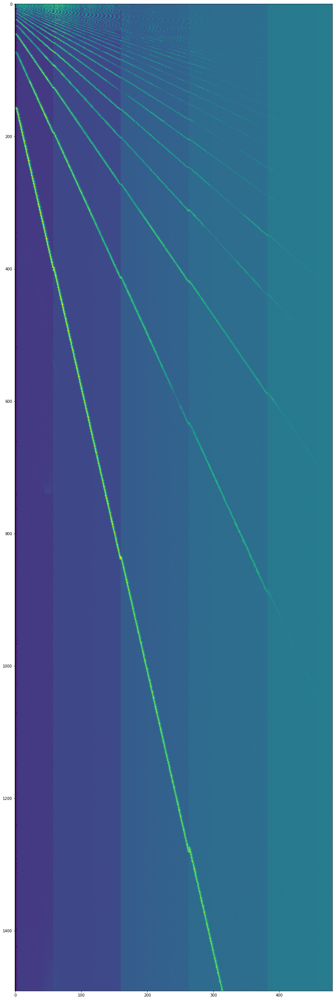

In [5]:
import sys, traceback

loSweep = None
for lo in loGrid:
    for retry in range(2):
        try:
            s.setFrequency(lo)
            #print(lo, s.isLocked(), end=' ')
            sa.updateTrace()
            f, t = sa.readTrace()
            loSweep = (np.vstack((loSweep, t)) if (loSweep is not None) else t)
        except Exception as ex:
            print(ex)
            traceback.print_exc(file=sys.stdout)
        else:
            break
    else:
        raise Exception("Error")
    
plt.rcParams['figure.figsize'] = [15, 90]
plt.imshow(loSweep)
plt.rcParams['figure.figsize'] = [15, 10] 

In [6]:
saveData('lo_high_power_output_red_a.mat', {'loGrid':loGrid, 'loSweep':loSweep})

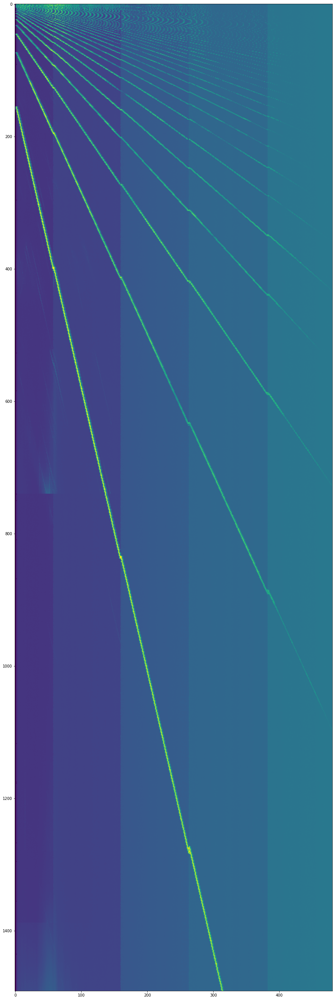

In [9]:
plt.rcParams['figure.figsize'] = [15, 90]
plt.imshow(loSweep)
plt.rcParams['figure.figsize'] = [15, 10]

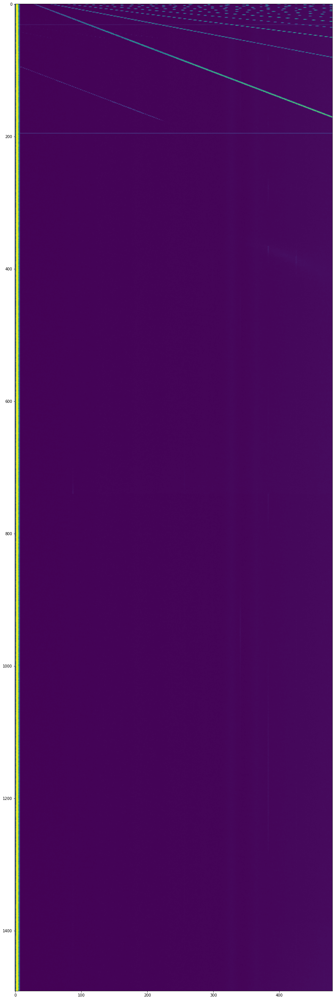

In [7]:
import sys, traceback

loSweep2 = None
for lo in loGrid:
    for retry in range(2):
        try:
            s.setFrequency(lo)
            #print(lo, s.isLocked(), end=' ')
            sa.updateTrace()
            f, t = sa.readTrace()
            loSweep2 = (np.vstack((loSweep2, t)) if (loSweep2 is not None) else t)
        except Exception as ex:
            print(ex)
            traceback.print_exc(file=sys.stdout)
        else:
            break
    else:
        raise Exception("Error")
    
plt.rcParams['figure.figsize'] = [15, 90]
plt.imshow(loSweep2)
plt.rcParams['figure.figsize'] = [15, 10] 

In [8]:
saveData('lo_low_band_power_output_red_a.mat', {'loGrid':loGrid, 'loSweep':loSweep2})

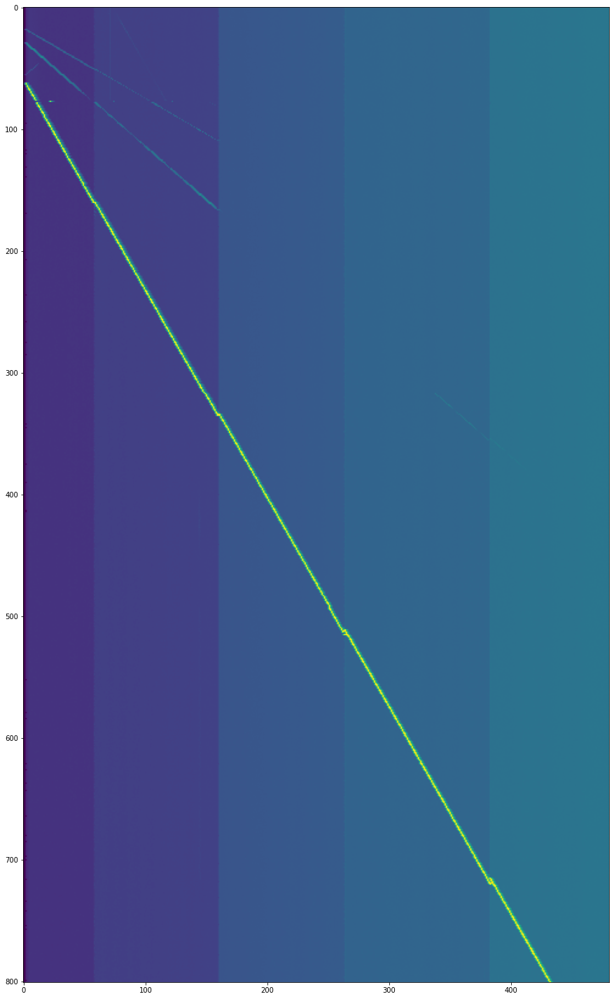

In [7]:
import sys, traceback
import time
rfSweep = None
for f in rfGrid:
    for retry in range(2):
        try:
            gen.setCwFreq(f)
            time.sleep(0.5)
            #print(lo, s.isLocked(), end=' ')
            sa.updateTrace()
            f, t = sa.readTrace()
            rfSweep = (np.vstack((rfSweep, t)) if (rfSweep is not None) else t)
        except Exception as ex:
            print(ex)
            traceback.print_exc(file=sys.stdout)
        else:
            break
    else:
        raise Exception("Error")
    
plt.rcParams['figure.figsize'] = [15, 90]
plt.imshow(rfSweep)
plt.rcParams['figure.figsize'] = [15, 10] 

In [8]:
saveData('rf_high.mat', {'rfGrid':rfGrid, 'rfSweep':rfSweep})

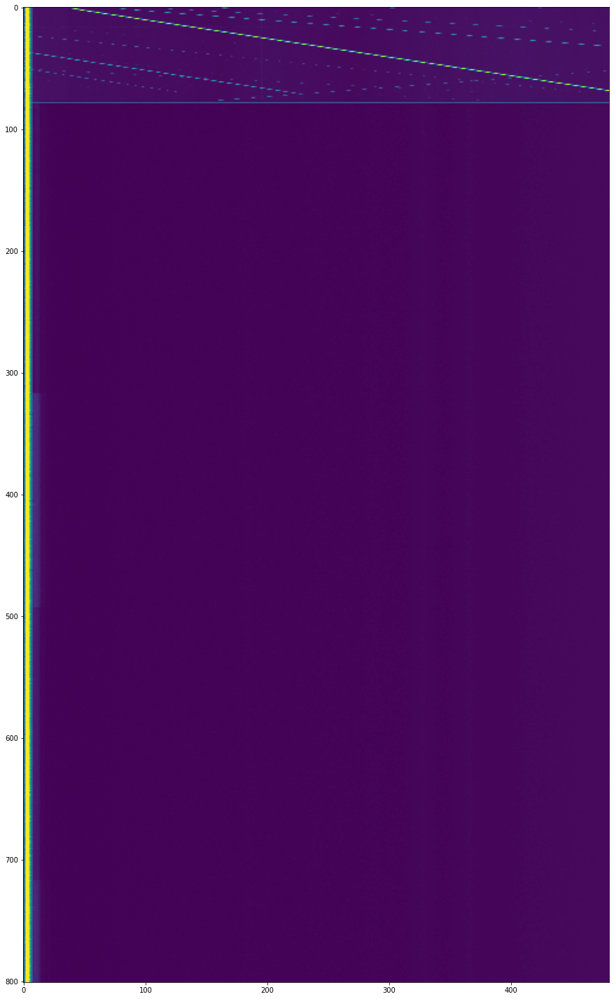

In [9]:
import sys, traceback
import time
rfSweep = None
for f in rfGrid:
    for retry in range(2):
        try:
            gen.setCwFreq(f)
            time.sleep(0.5)
            #print(lo, s.isLocked(), end=' ')
            sa.updateTrace()
            f, t = sa.readTrace()
            rfSweep = (np.vstack((rfSweep, t)) if (rfSweep is not None) else t)
        except Exception as ex:
            print(ex)
            traceback.print_exc(file=sys.stdout)
        else:
            break
    else:
        raise Exception("Error")
    
plt.rcParams['figure.figsize'] = [15, 90]
plt.imshow(rfSweep)
plt.rcParams['figure.figsize'] = [15, 10] 

## IF sweeps

In [6]:
import time
def ifSweep(fif, flo):
    ifSweepData=None
    for fr in flo:
        fgen = np.abs(fr+fif)
        if fgen < 10e6:
            fgen = 10e6
        gen.setCwFreq(fgen)
        lo.setFrequency(fr)
        time.sleep(1)
        sa.updateTrace()
        f, t = sa.readTrace()
        ifSweepData = (np.vstack((ifSweepData, t)) if (ifSweepData is not None) else t)
    return ifSweepData, f
        

## Wide band sweeps

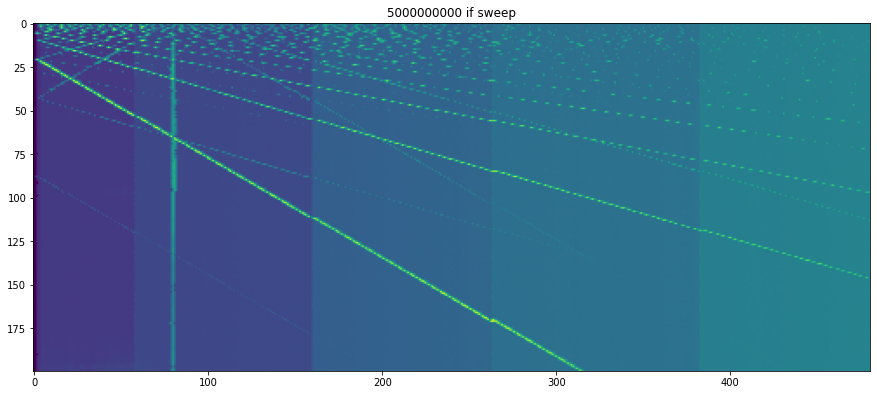

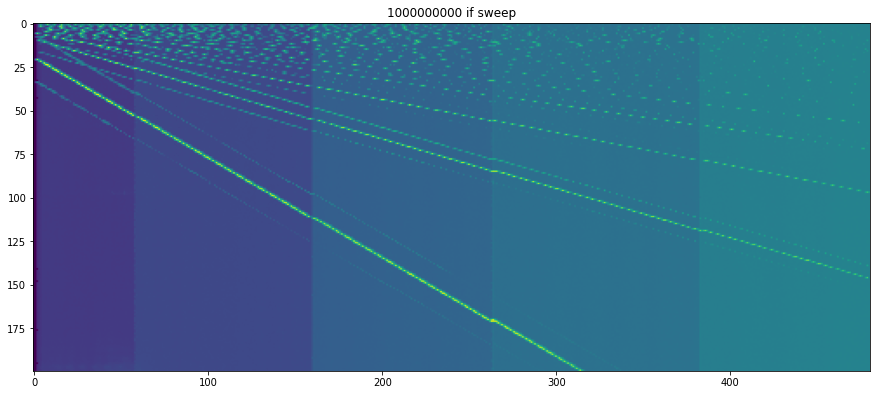

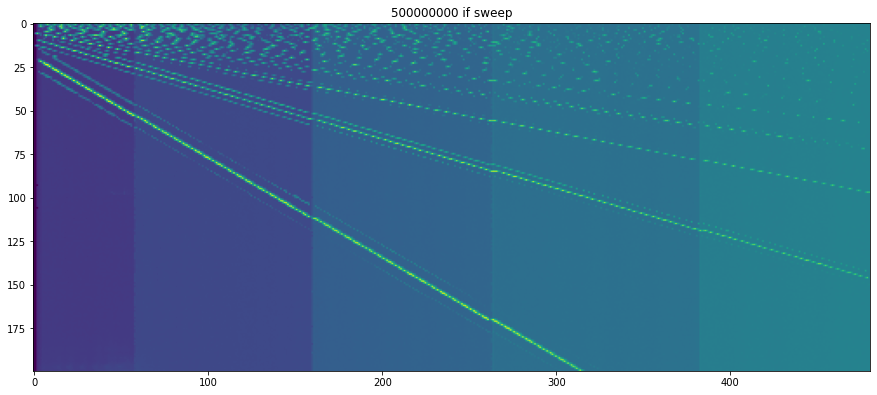

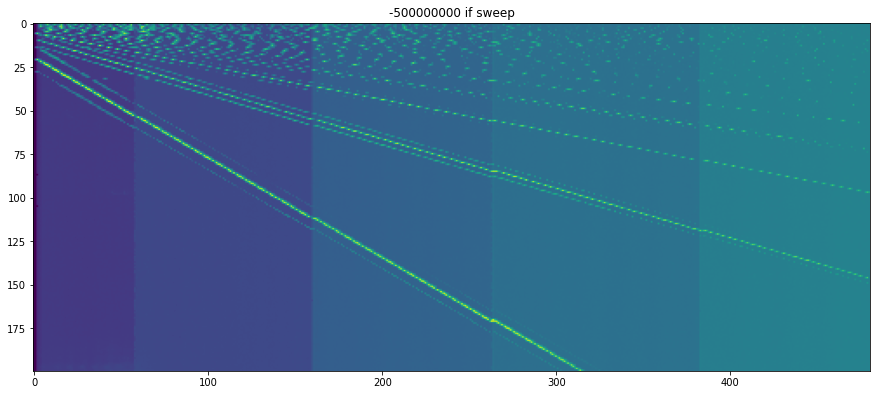

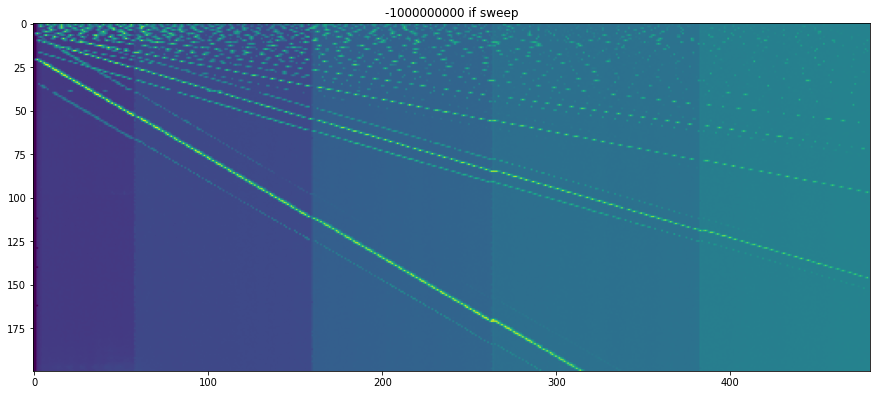

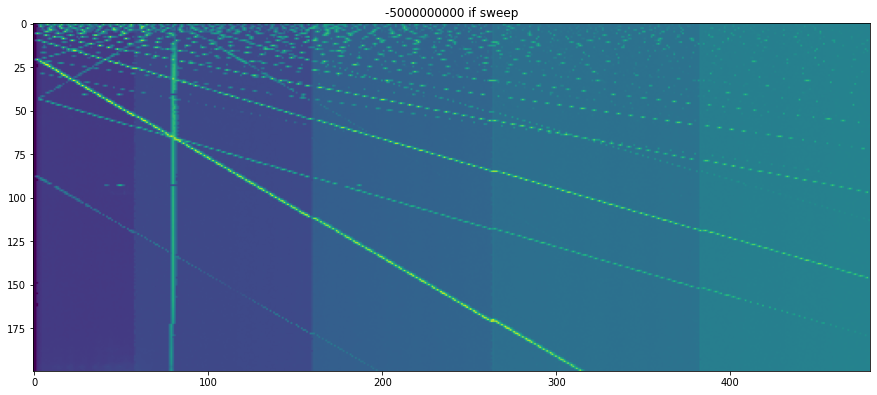

In [51]:
## High band
ifFreq = np.array([-5, -1, -0.5,  0.5, 1, 5])*-1e9
loSweep = np.linspace(0.1e9, 15e9, 200)
gen.setLevel(0)
mats = None
for iff in ifFreq:
    fmap, f = ifSweep(iff, loSweep)
    mats = (np.dstack((mats, fmap)) if (mats is not None) else fmap)
    plt.figure()
    plt.title("%d if sweep"%(iff))
    plt.imshow(fmap)
    plt.show()

(200, 481, 6)


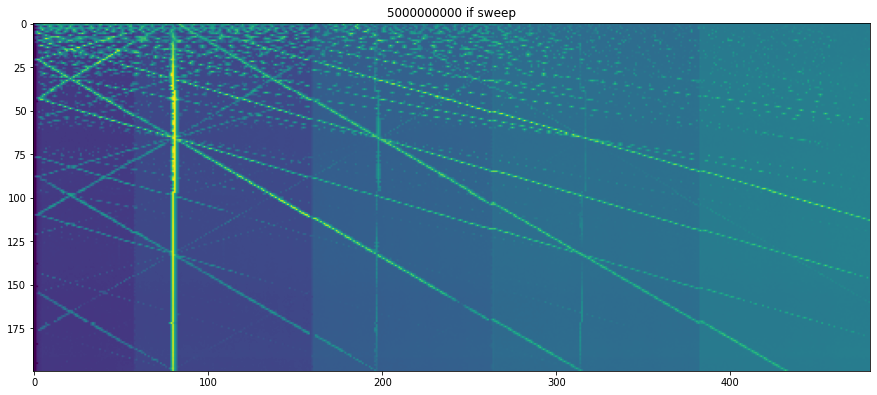

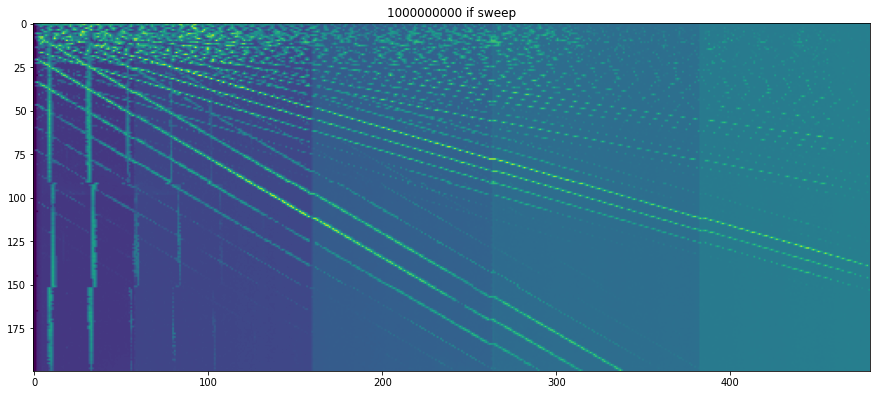

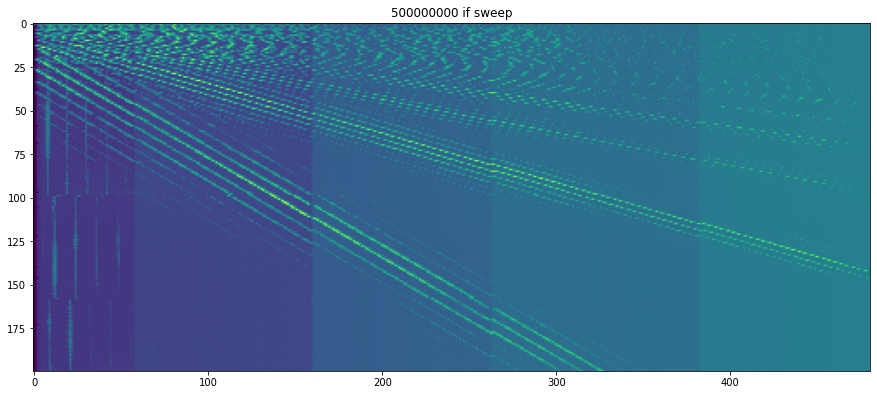

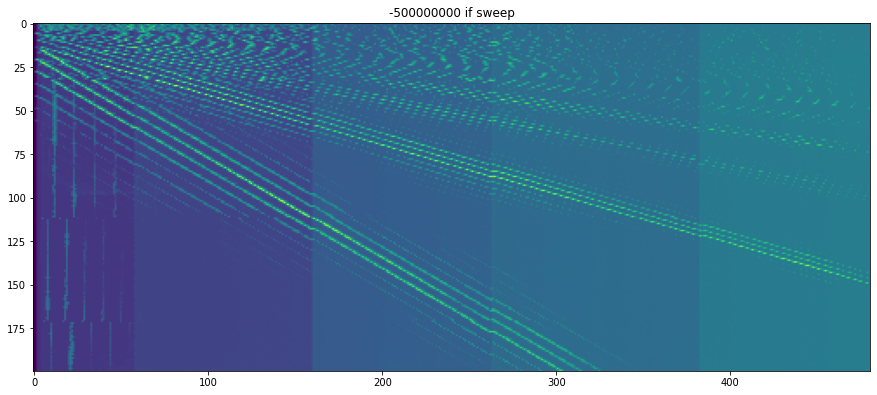

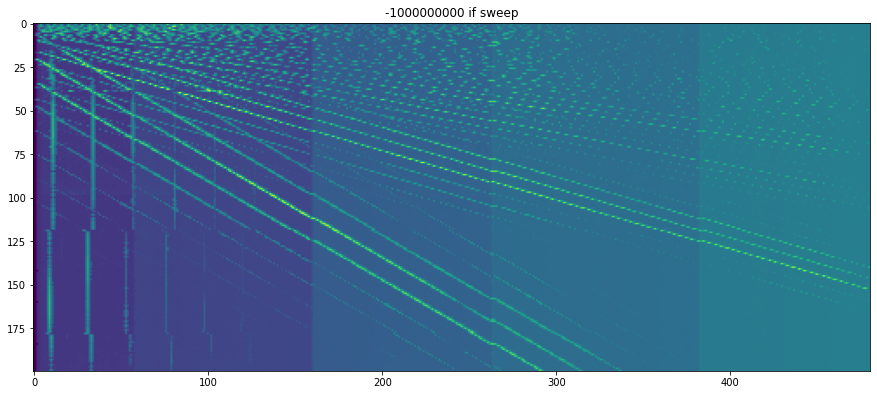

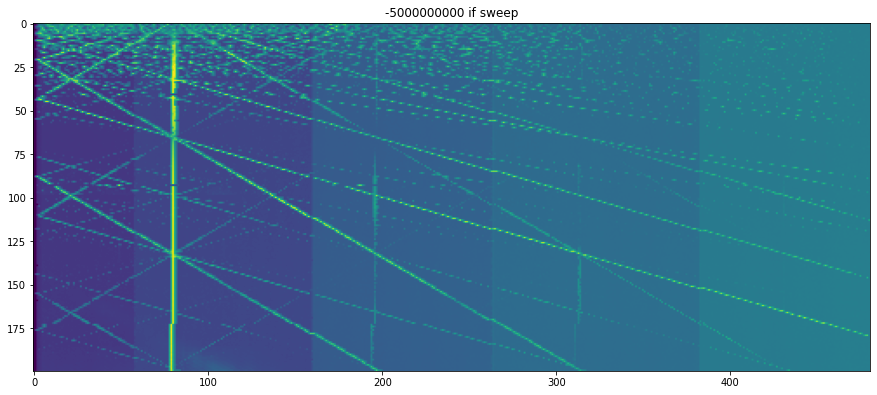

In [54]:
print(mats.shape)
nmat = mats.shape[2]
for i in range(nmat):
    plt.figure()
    plt.title("%d if sweep"%(ifFreq[i]))
    plt.imshow(np.squeeze(mats[:,:,i]))

In [52]:
loSweep = np.linspace(0.1e9, 15e9, 300);
saveData('high_band_mixer.mat', {'freqs':f, 'ifFreqs': ifFreq, 'loSweep':loSweep, 'measuredData':mats})

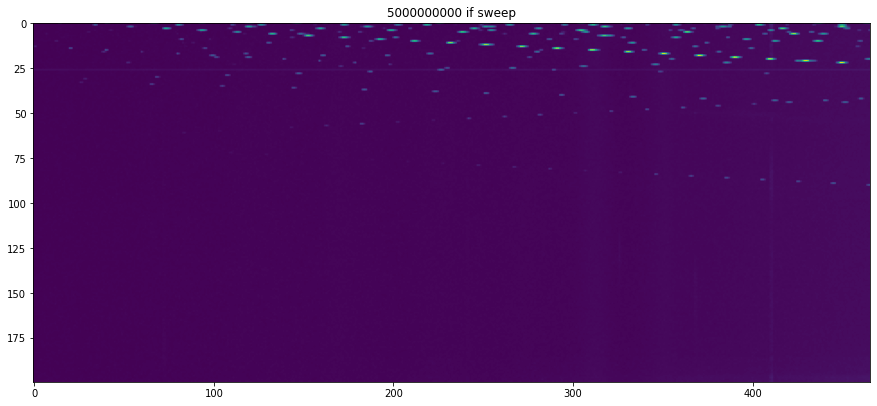

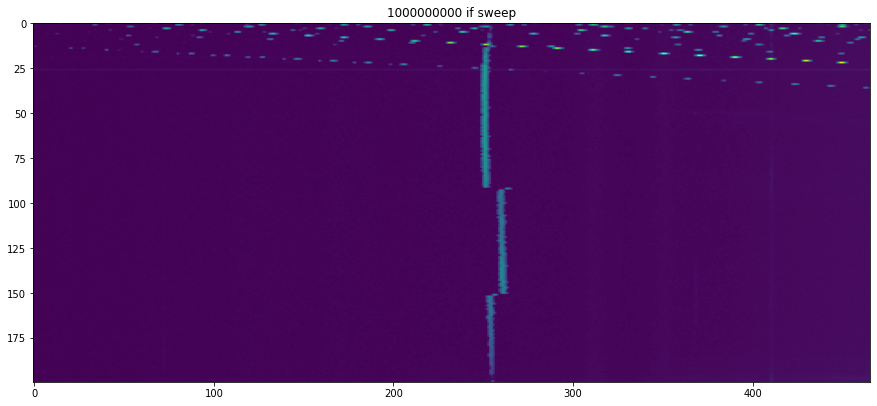

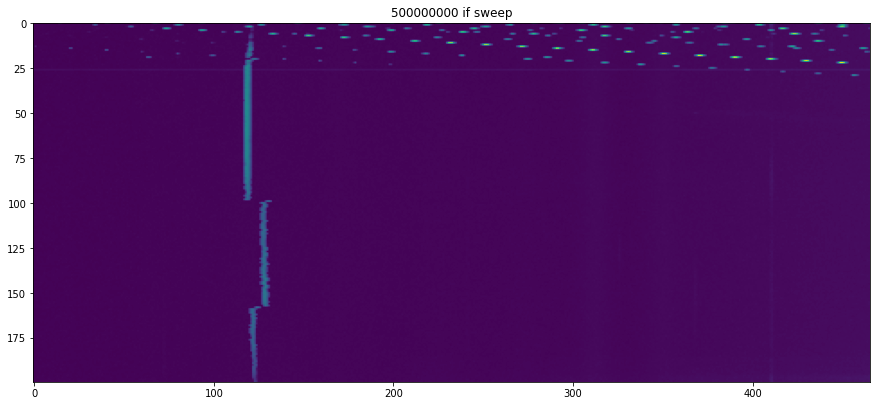

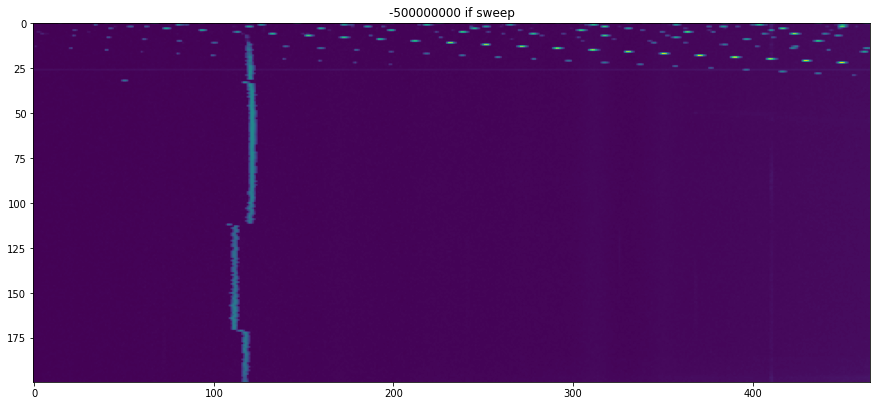

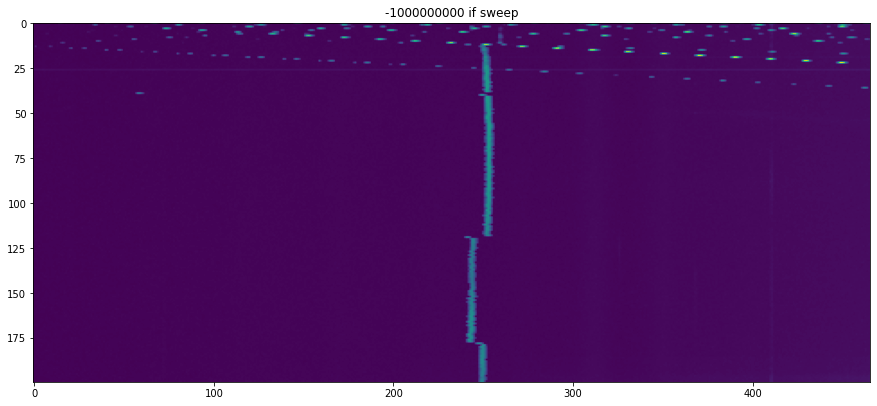

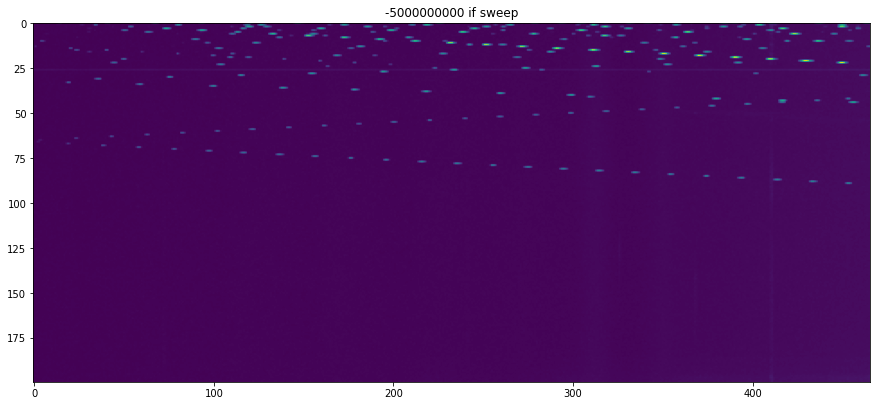

In [53]:
## low band
ifFreq = np.array([-5, -1, -0.5,  0.5, 1, 5])*-1e9
loSweep = np.linspace(0.1e9, 15e9, 200)
mats = None
for iff in ifFreq:
    fmap, f = ifSweep(iff, loSweep)
    mats = (np.dstack((mats, fmap)) if (mats is not None) else fmap)
    plt.figure()
    plt.title("%d if sweep"%(iff))
    plt.imshow(fmap[:, 15:])
    plt.show()
ifFreq = np.array([-5, -1, -0.5,  0.5, 1, 5])*-1e9

(200, 481, 6)


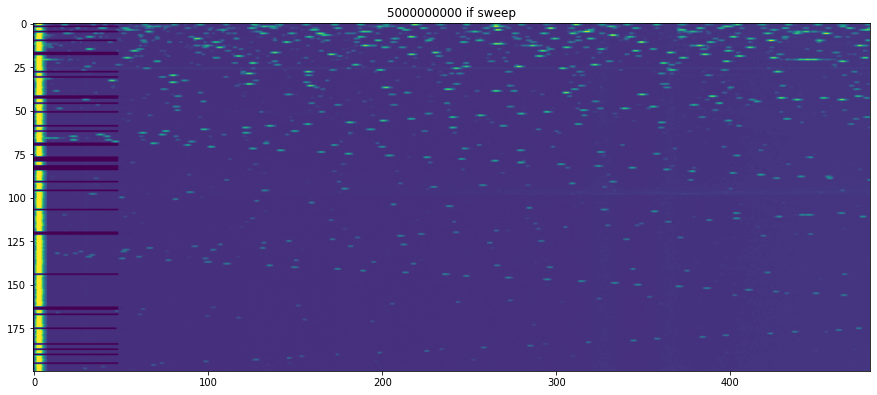

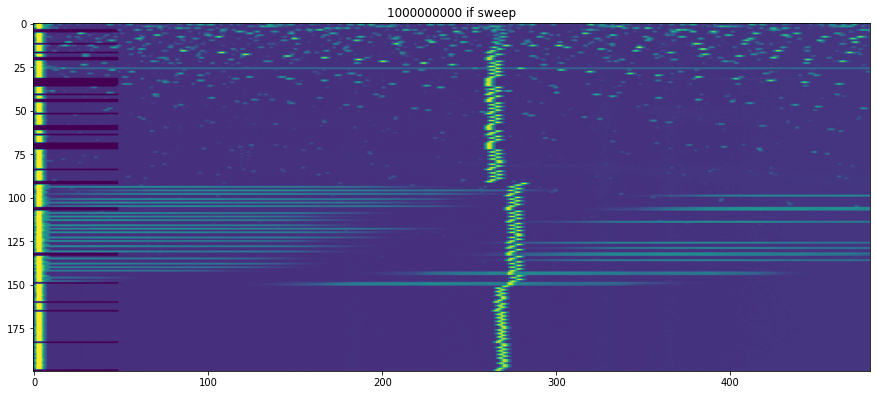

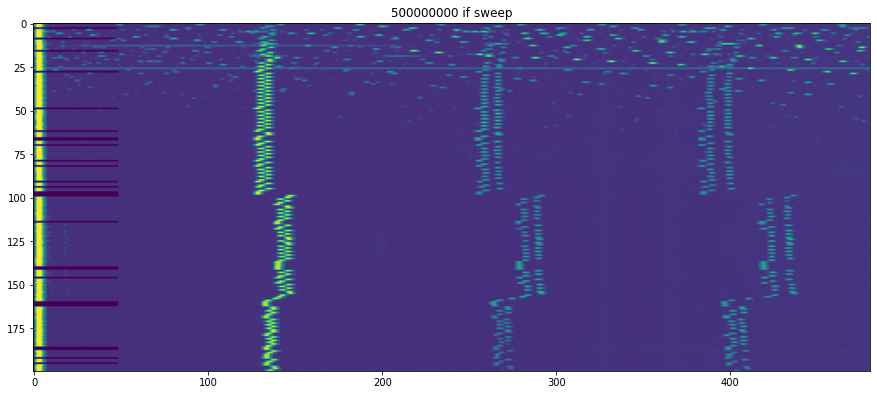

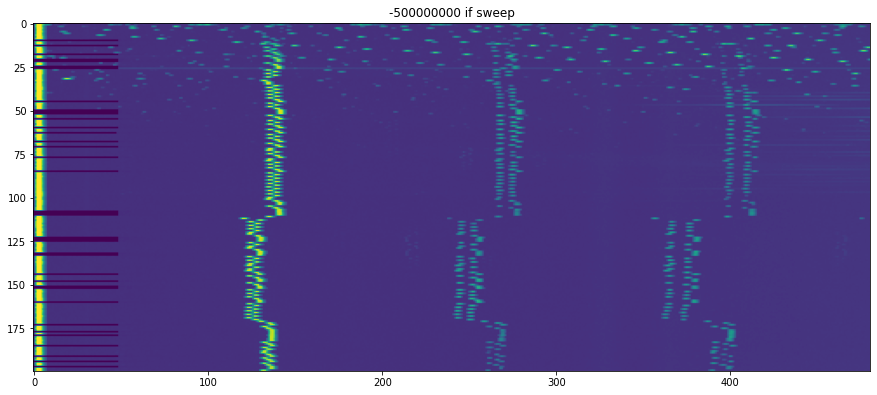

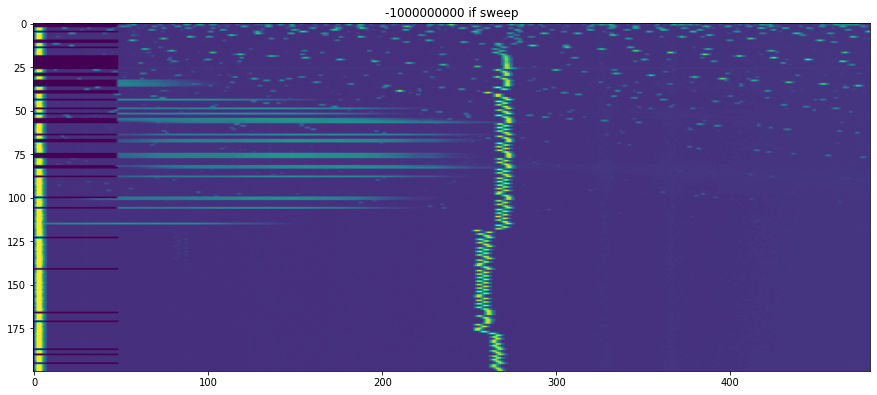

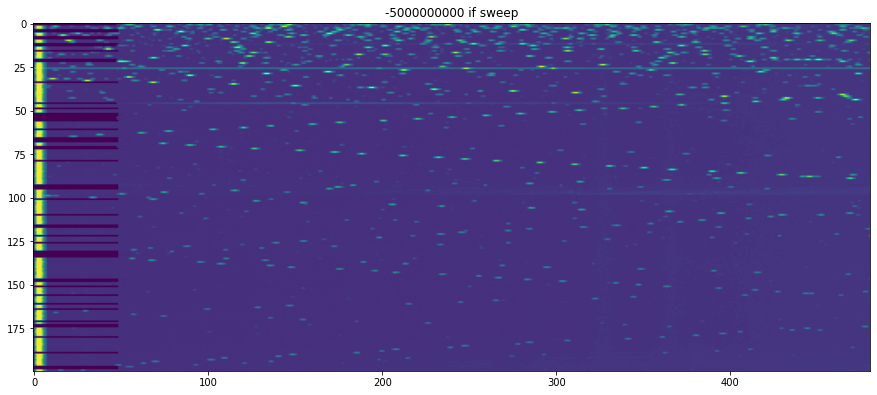

In [49]:
print(mats.shape)
nmat = mats.shape[2]
for i in range(nmat):
    plt.figure()
    plt.title("%d if sweep"%(ifFreq[i]))
    plt.imshow(np.squeeze(mats[:,:,i]))

In [54]:
loSweep = np.linspace(0.1e9, 15e9, 300);
saveData('low_band_mixer.mat', {'freqs':f, 'ifFreqs': ifFreq, 'loSweep':loSweep, 'measuredData':mats})

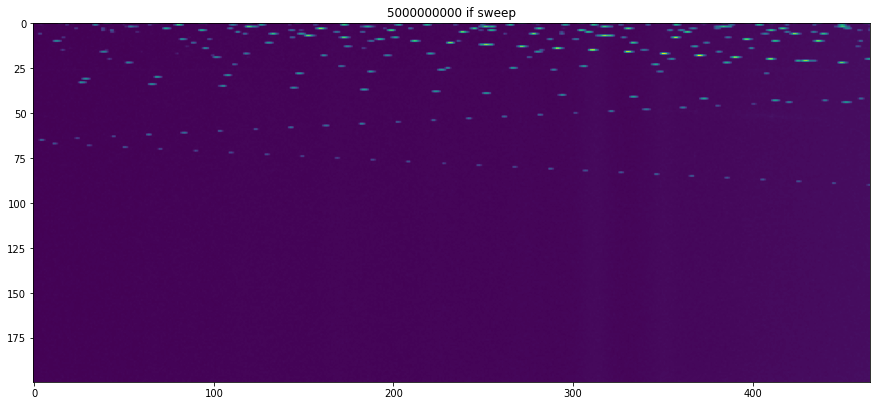

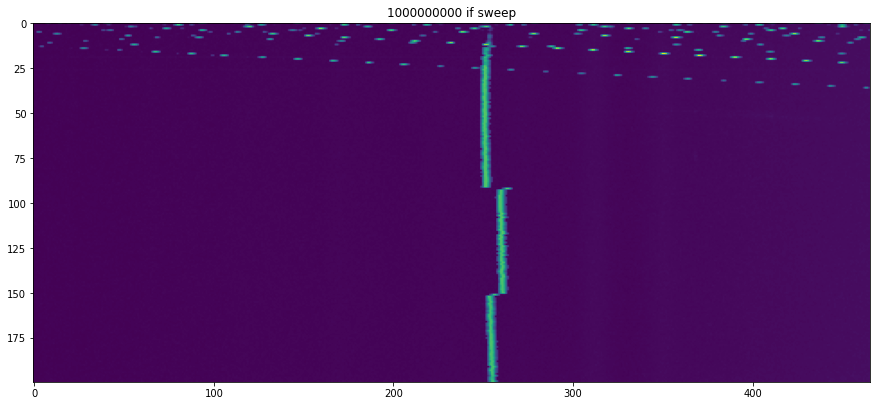

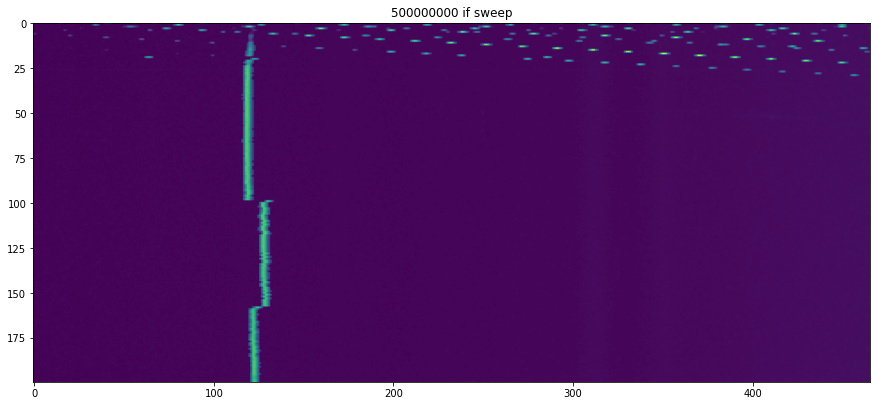

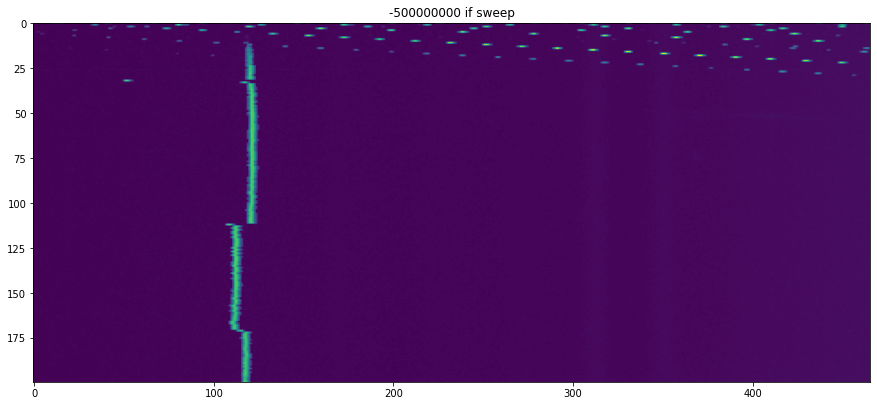

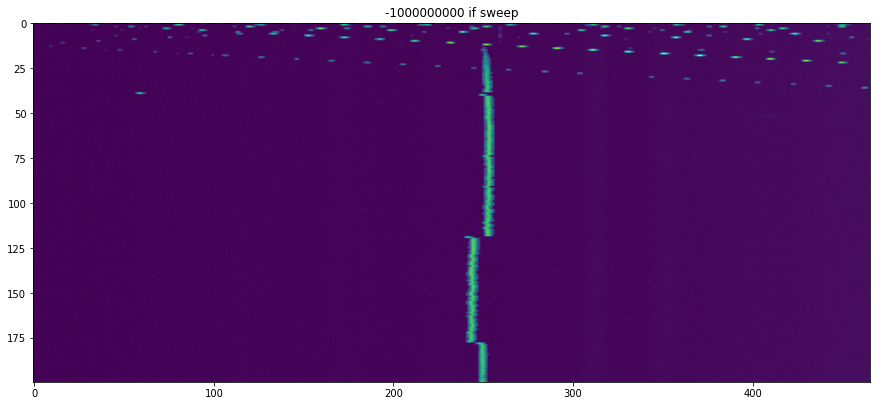

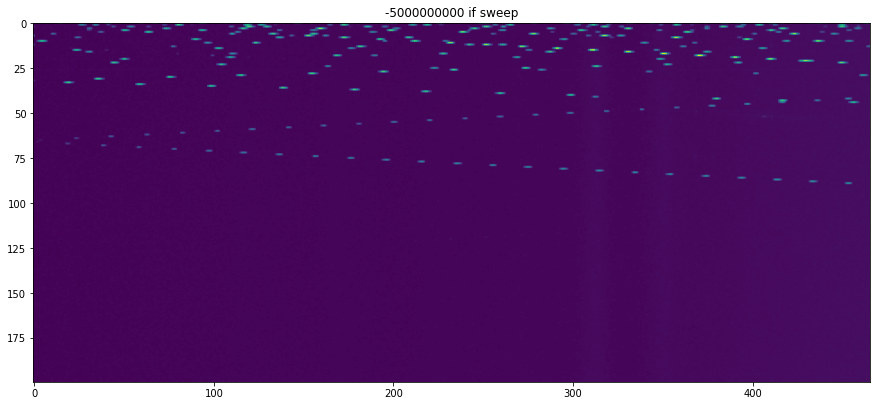

In [56]:
## low band
ifFreq = np.array([-5, -1, -0.5,  0.5, 1, 5])*-1e9
loSweep = np.linspace(0.1e9, 15e9, 200)
mats = None
for iff in ifFreq:
    fmap, f = ifSweep(iff, loSweep)
    mats = (np.dstack((mats, fmap)) if (mats is not None) else fmap)
    plt.figure()
    plt.title("%d if sweep"%(iff))
    plt.imshow(fmap[:, 15:])
    plt.show()
ifFreq = np.array([-5, -1, -0.5,  0.5, 1, 5])*-1e9

In [57]:
loSweep = np.linspace(0.1e9, 15e9, 300);
saveData('low_band_mixer_rf_to_if.mat', {'freqs':f, 'ifFreqs': ifFreq, 'loSweep':loSweep, 'measuredData':mats})

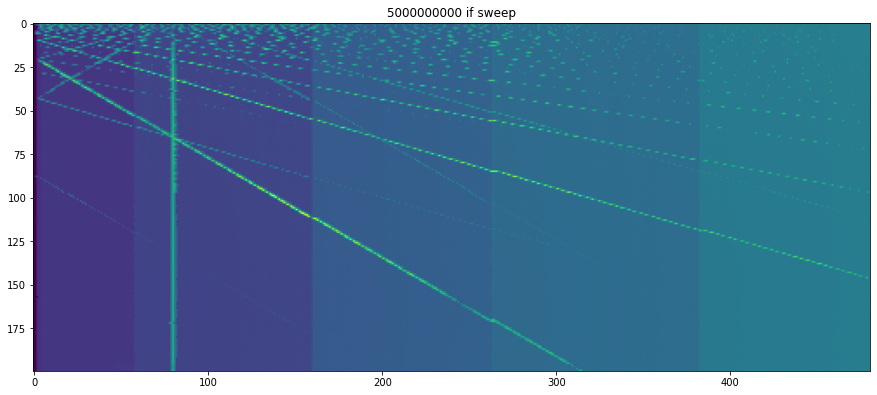

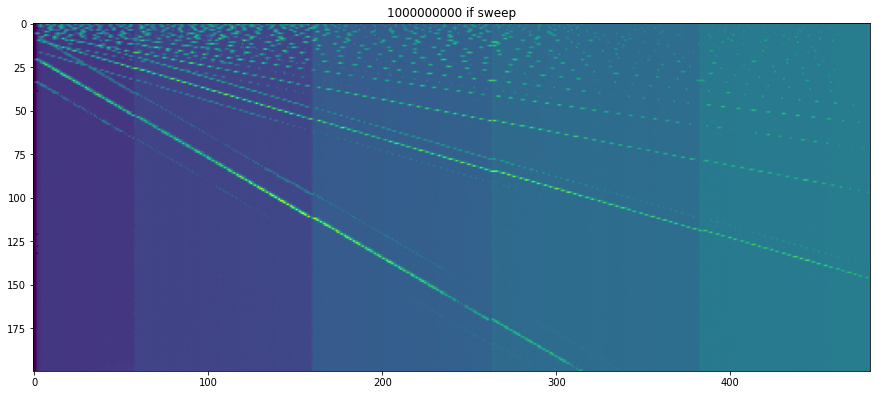

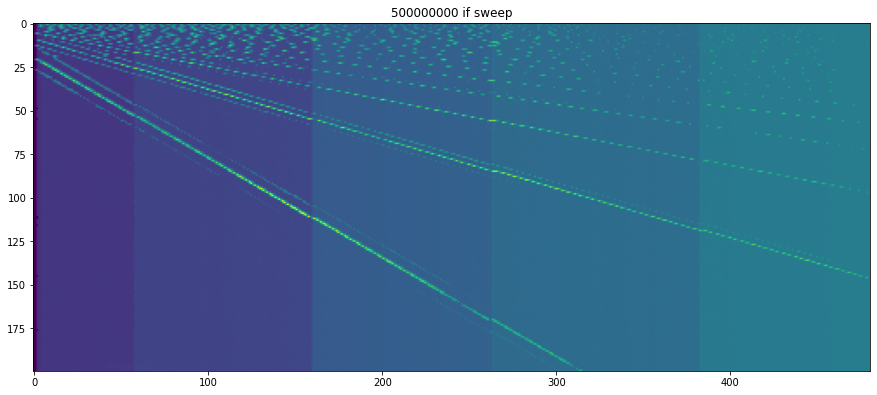

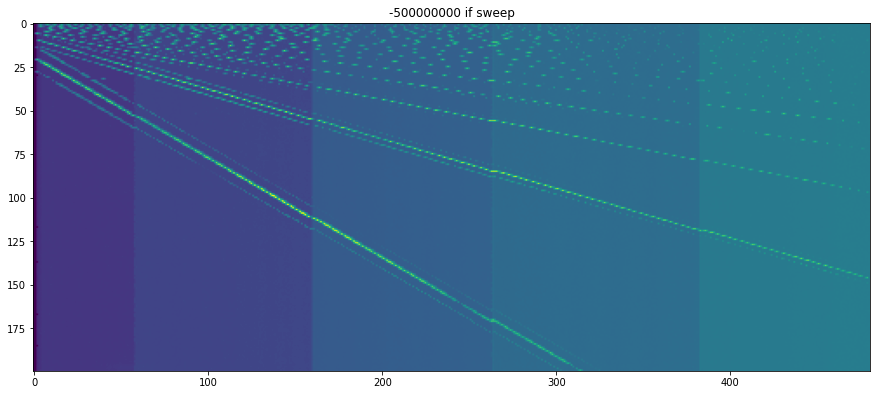

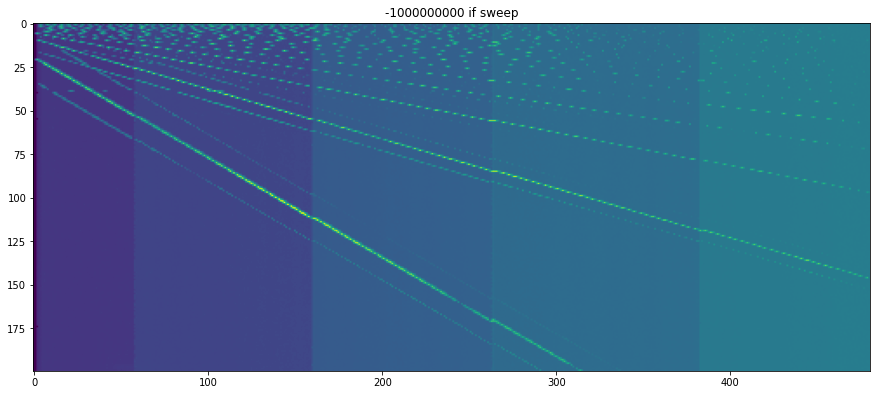

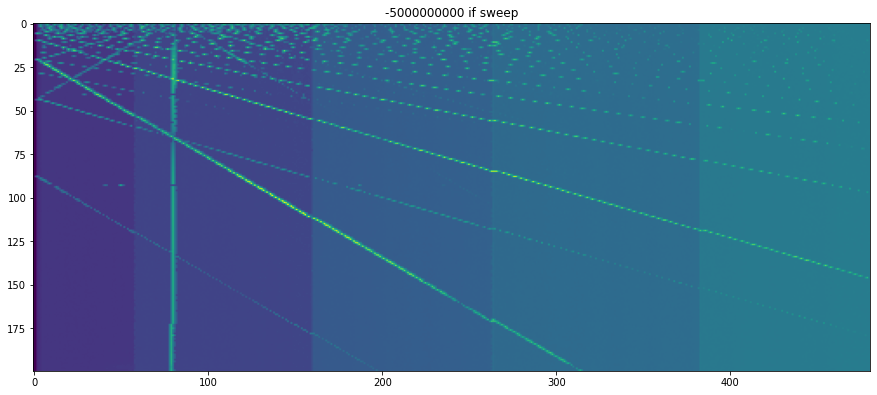

In [58]:
## High band
ifFreq = np.array([-5, -1, -0.5,  0.5, 1, 5])*-1e9
loSweep = np.linspace(0.1e9, 15e9, 200)
gen.setLevel(0)
mats = None
for iff in ifFreq:
    fmap, f = ifSweep(iff, loSweep)
    mats = (np.dstack((mats, fmap)) if (mats is not None) else fmap)
    plt.figure()
    plt.title("%d if sweep"%(iff))
    plt.imshow(fmap)
    plt.show()

In [59]:
#loSweep = np.linspace(0.1e9, 15e9, 300);
saveData('high_band_mixer_rf_to_if.mat', {'freqs':f, 'ifFreqs': ifFreq, 'loSweep':loSweep, 'measuredData':mats})

In [ ]:
fmap, f = ifSweep(-3e9, np.linspace(0.1e9, 15e9, 300))
plt.imshow(fmap)

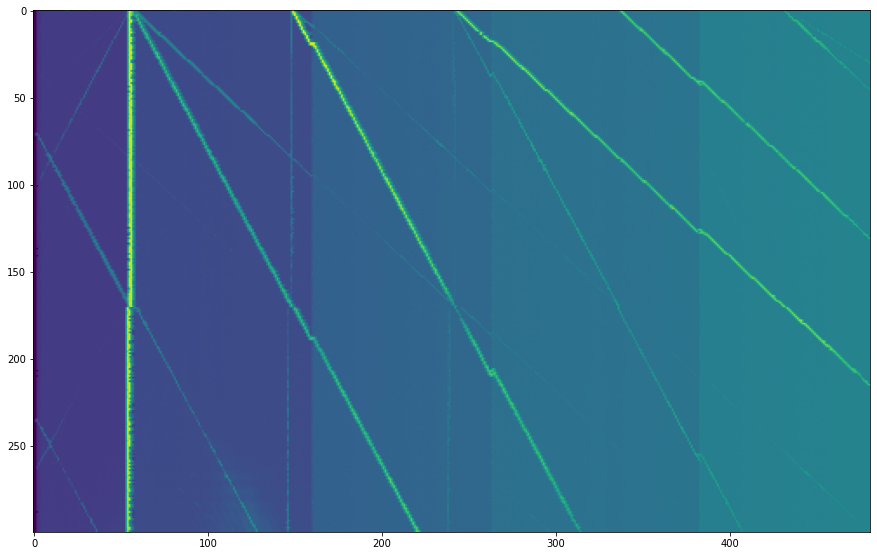

In [59]:
fmap, f = ifSweep(4e9, np.linspace(4e9, 11e9, 300))
plt.imshow(fmap)

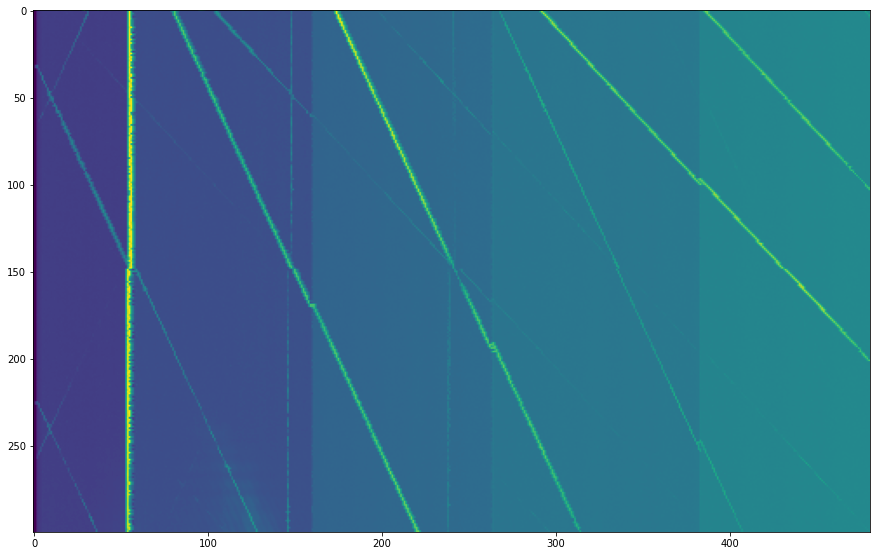

In [60]:
fmap, f = ifSweep(4e9, np.linspace(5e9, 11e9, 300), lsb=False)
plt.imshow(fmap)

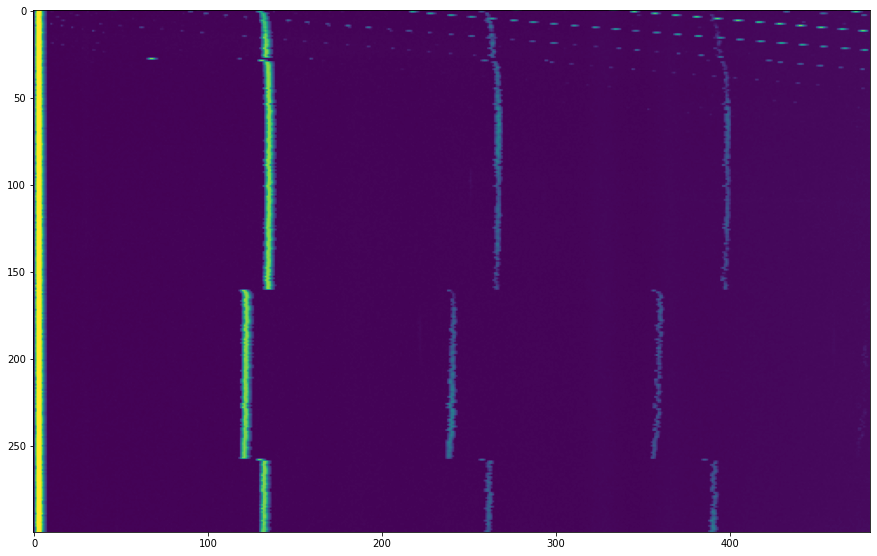

In [61]:
fmap, f = ifSweep(0.5e9, np.linspace(0.75e9, 14.25e9, 300))
plt.imshow(fmap)

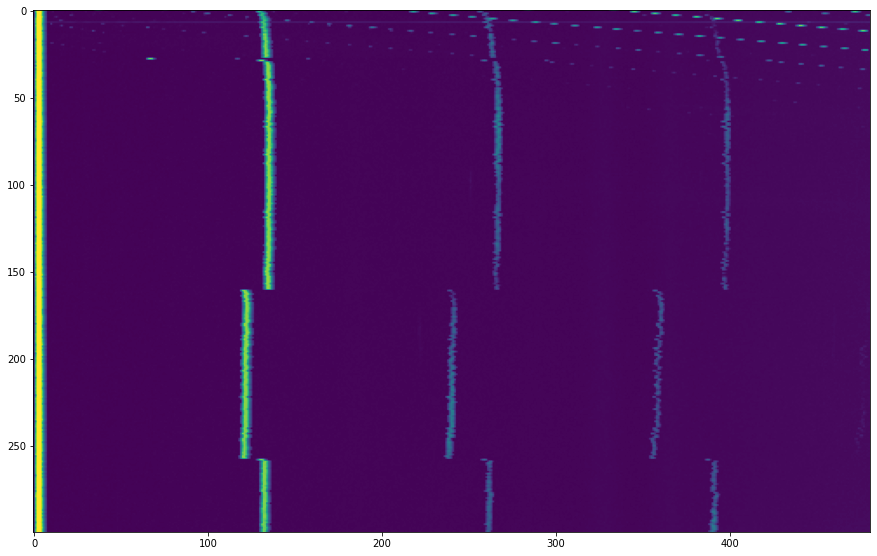

In [62]:
fmap, f = ifSweep(0.5e9, np.linspace(0.75e9, 14.25e9, 300), lsb=False)
plt.imshow(fmap)

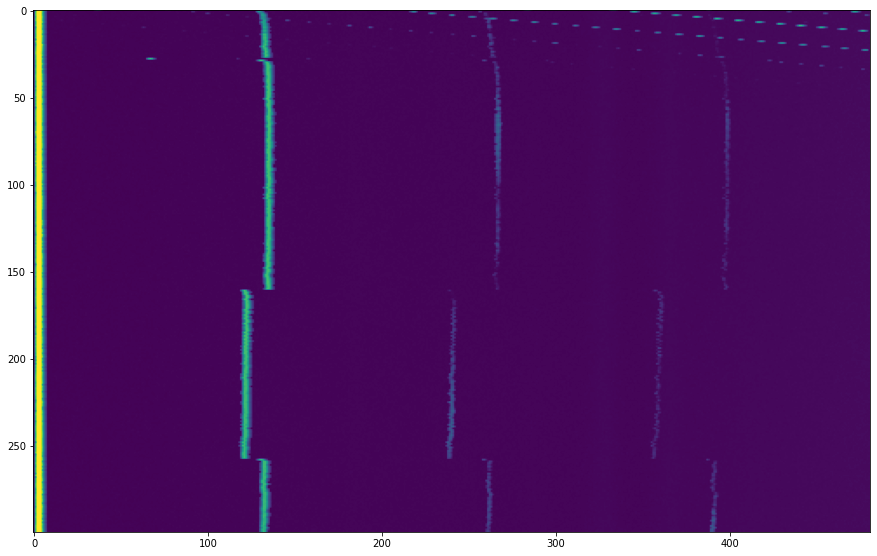

In [63]:
fmap, f = ifSweep(0.5e9, np.linspace(0.75e9, 14.25e9, 300), lsb=False)
plt.imshow(fmap)

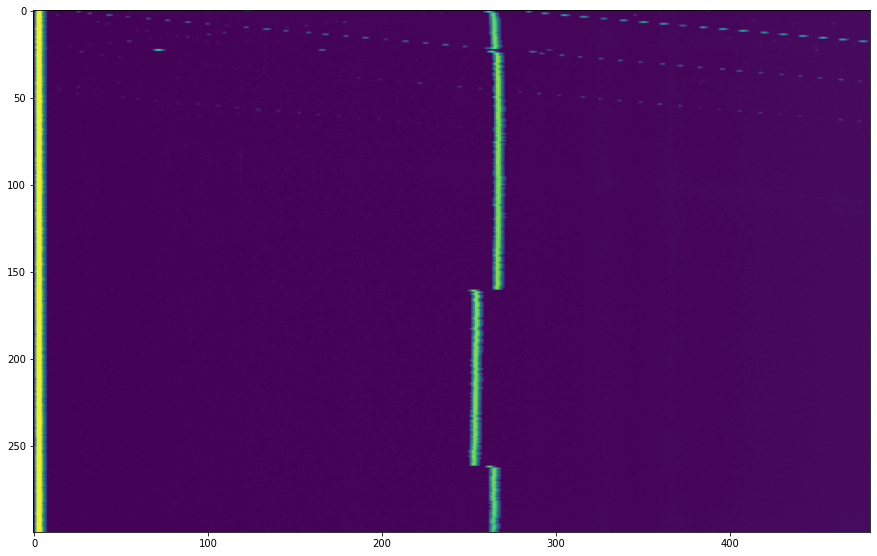

In [65]:
fmap, f = ifSweep(1e9, np.linspace(1e9, 14e9, 300), lsb=False)
plt.imshow(fmap)

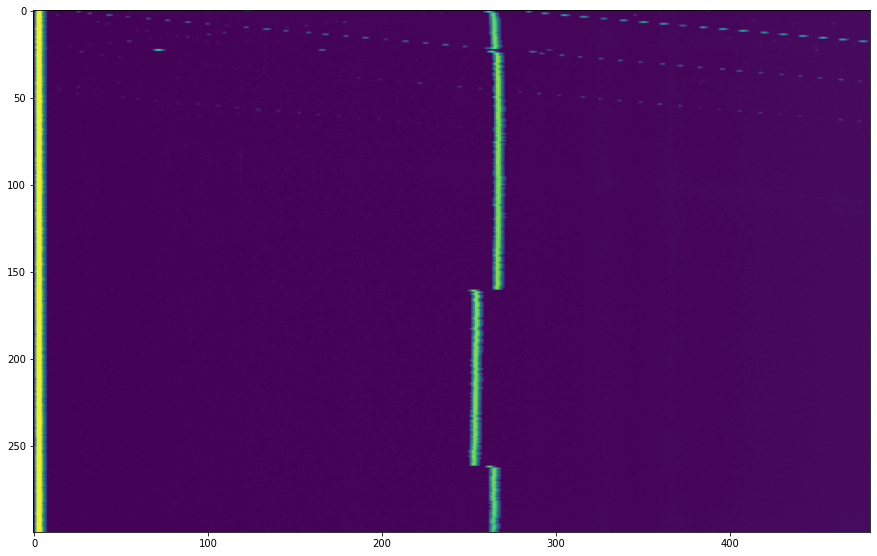

In [65]:
fmap, f = ifSweep(1e9, np.linspace(1e9, 14e9, 300), lsb=False)
plt.imshow(fmap)

In [70]:
s.setFrequency(15e9)
gen.setCwFreq(15.4e9)

In [4]:
def computeSpurs(flo, frf, n = 20, fmin = None, fmax= None):
    spurs=[]
    n = np.arange(-n,n)
    for fn in n:
        for lon in n:
            sf = fn*frf+lon*flo
            notUse = False
            if fmin is not None:
                if sf < fmin:
                    notUse = True
            if fmax is not None:
                if sf > fmax:
                    notUse = True
            if not notUse:
                spurs.append(sf)
    return np.array(spurs)

def plotTraceAndSpurs(f, t, spurs):
    spurAmp = np.interp(spurs, f, t)
    plt.plot(f, t)
    plt.plot(spurs, spurAmp, 'x')

[2.e+09]


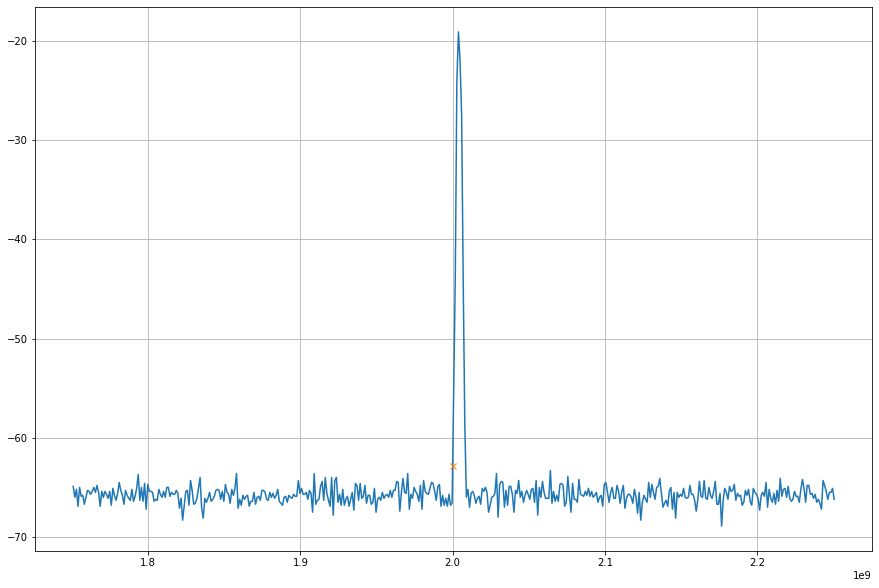

In [7]:

rf = 10.6e9;
i = 0.5e9
gen.setCwFreq(rf-15e6)
lo.setFrequency(2e9)
f, t = sa.readTrace()

spurs = computeSpurs(rf, rf+i, fmin=np.min(f), fmax = np.max(f), n = 5)
plotTraceAndSpurs(f, t, spurs)
print(spurs)
plt.grid();

## IF sweeps looking at 500MHz spans at mixer IF ports

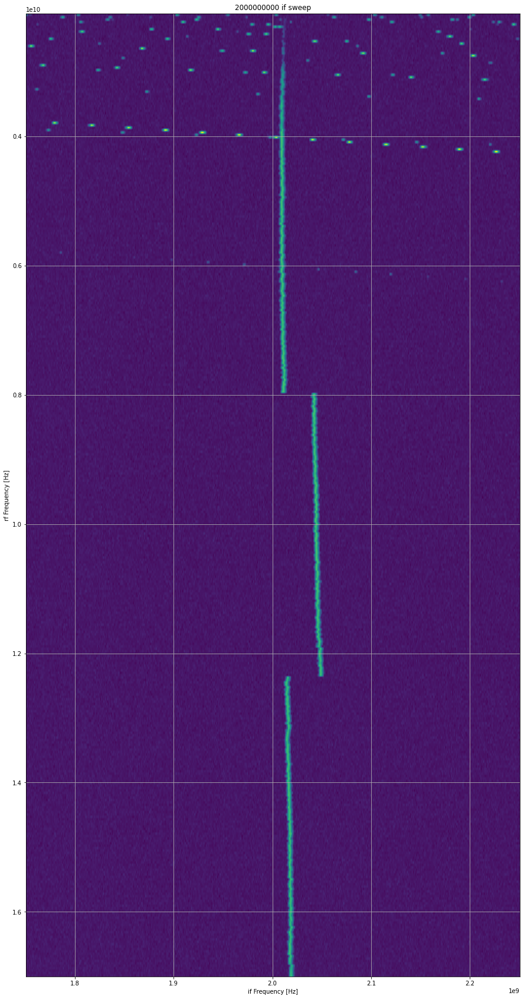

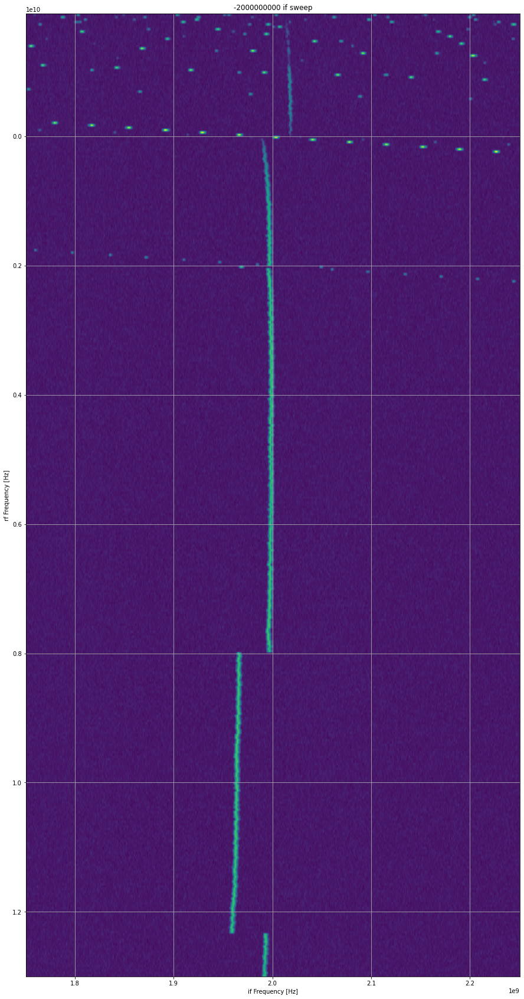

In [66]:
plt.rcParams['figure.figsize'] = [15, 30]
ifFreq = np.array([2, -2])*1e9
loSweep = np.linspace(0.1e9, 15e9, 401)
gen.setLevel(0)
mats = None
for iff in ifFreq:
    fmap, f = ifSweep(iff, loSweep)
    mats = (np.dstack((mats, fmap)) if (mats is not None) else fmap)
    plt.figure()
    plt.title("%d if sweep"%(iff))
    plt.imshow(fmap, extent=[min(f), max(f), max(loSweep)+iff, min(loSweep)+iff], aspect='auto')
    plt.xlabel('if Frequency [Hz]')
    plt.ylabel('rf Frequency [Hz]')
    plt.grid(True)
    plt.show()

In [67]:
#loSweep = np.linspace(0.1e9, 15e9, 300);
saveData('2GHz_if_sweeps.mat', {'freqs':f, 'ifFreqs': ifFreq, 'loSweep':loSweep, 'measuredData':mats})

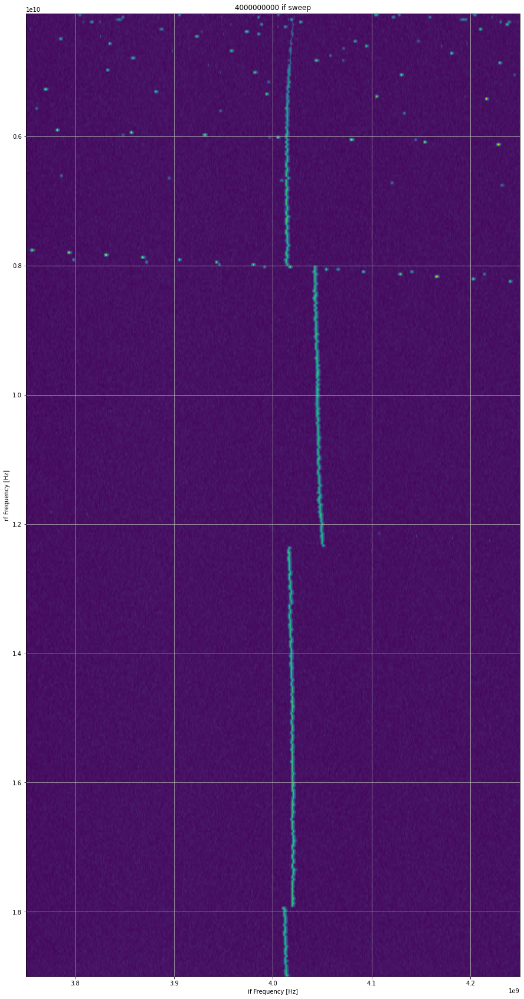

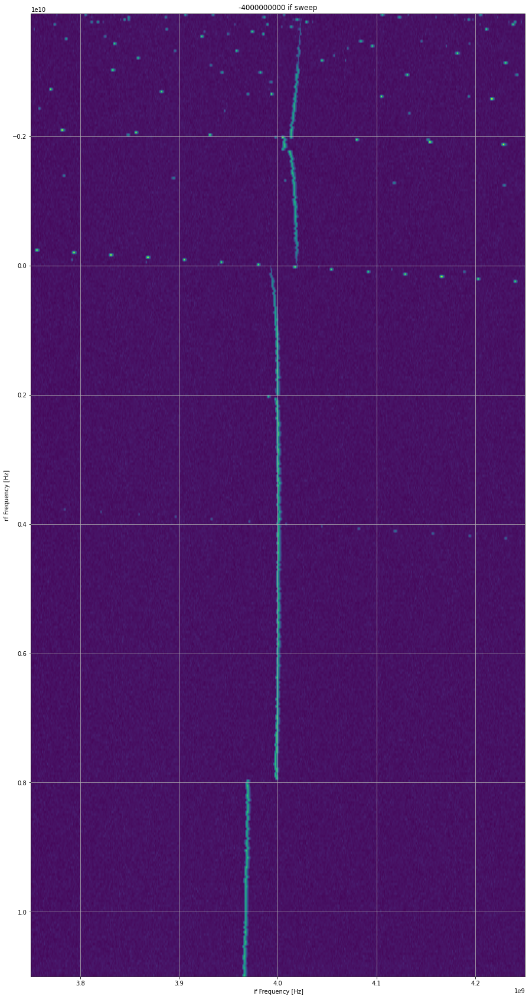

In [69]:
plt.rcParams['figure.figsize'] = [15, 30]
ifFreq = np.array([4, -4])*1e9
loSweep = np.linspace(0.1e9, 15e9, 401)
gen.setLevel(0)
mats = None
for iff in ifFreq:
    fmap, f = ifSweep(iff, loSweep)
    mats = (np.dstack((mats, fmap)) if (mats is not None) else fmap)
    plt.figure()
    plt.title("%d if sweep"%(iff))
    plt.imshow(fmap, extent=[min(f), max(f), max(loSweep)+iff, min(loSweep)+iff], aspect='auto')
    plt.xlabel('if Frequency [Hz]')
    plt.ylabel('rf Frequency [Hz]')
    plt.grid(True)
    plt.show()
#loSweep = np.linspace(0.1e9, 15e9, 300);
saveData('4GHz_if_sweeps.mat', {'freqs':f, 'ifFreqs': ifFreq, 'loSweep':loSweep, 'measuredData':mats})

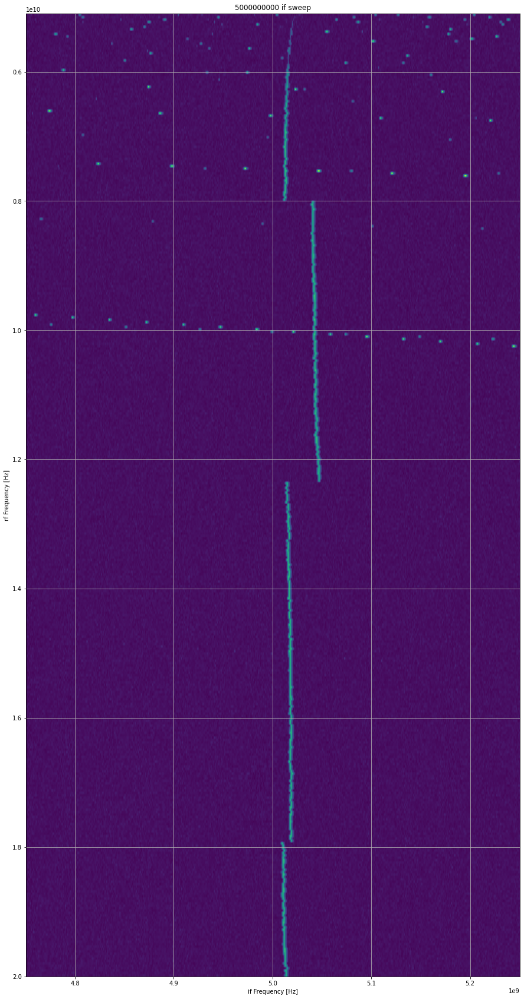

In [ ]:
plt.rcParams['figure.figsize'] = [15, 30]
ifFreq = np.array([5, -5])*1e9
loSweep = np.linspace(0.1e9, 15e9, 401)
gen.setLevel(0)
mats = None
for iff in ifFreq:
    fmap, f = ifSweep(iff, loSweep)
    mats = (np.dstack((mats, fmap)) if (mats is not None) else fmap)
    plt.figure()
    plt.title("%d if sweep"%(iff))
    plt.imshow(fmap, extent=[min(f), max(f), max(loSweep)+iff, min(loSweep)+iff], aspect='auto')
    plt.xlabel('if Frequency [Hz]')
    plt.ylabel('rf Frequency [Hz]')
    plt.grid(True)
    plt.show()
#loSweep = np.linspace(0.1e9, 15e9, 300);
saveData('5GHz_if_sweeps.mat', {'freqs':f, 'ifFreqs': ifFreq, 'loSweep':loSweep, 'measuredData':mats})

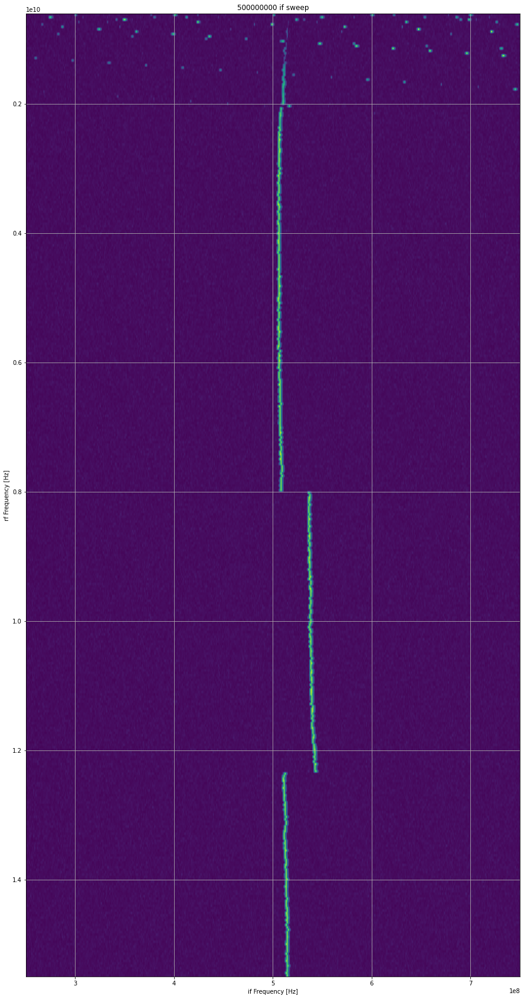

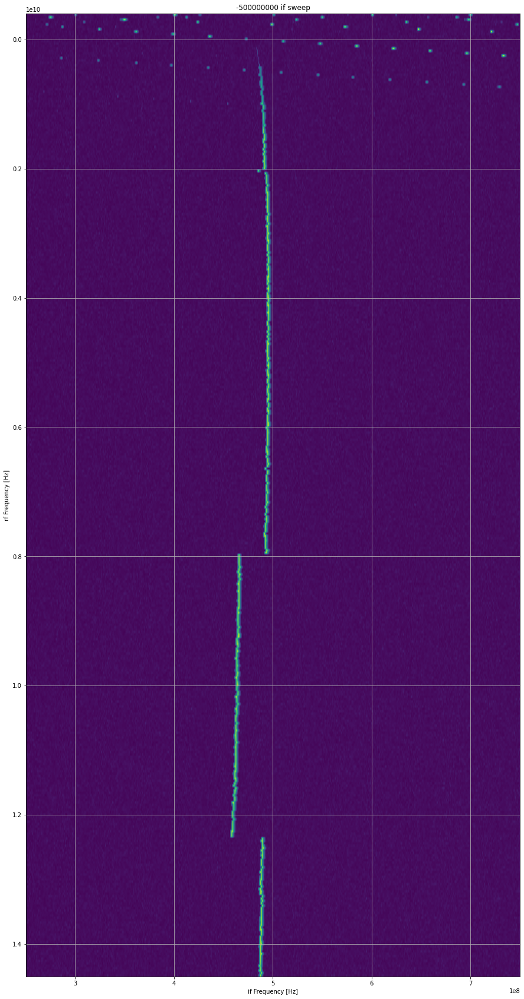

In [71]:
plt.rcParams['figure.figsize'] = [15, 30]
ifFreq = np.array([0.5, -0.5])*1e9
loSweep = np.linspace(0.1e9, 15e9, 401)
gen.setLevel(0)
mats = None
for iff in ifFreq:
    fmap, f = ifSweep(iff, loSweep)
    mats = (np.dstack((mats, fmap)) if (mats is not None) else fmap)
    plt.figure()
    plt.title("%d if sweep"%(iff))
    plt.imshow(fmap, extent=[min(f), max(f), max(loSweep)+iff, min(loSweep)+iff], aspect='auto')
    plt.xlabel('if Frequency [Hz]')
    plt.ylabel('rf Frequency [Hz]')
    plt.grid(True)
    plt.show()
#loSweep = np.linspace(0.1e9, 15e9, 300);
saveData('0_5GHz_if_sweeps.mat', {'freqs':f, 'ifFreqs': ifFreq, 'loSweep':loSweep, 'measuredData':mats})

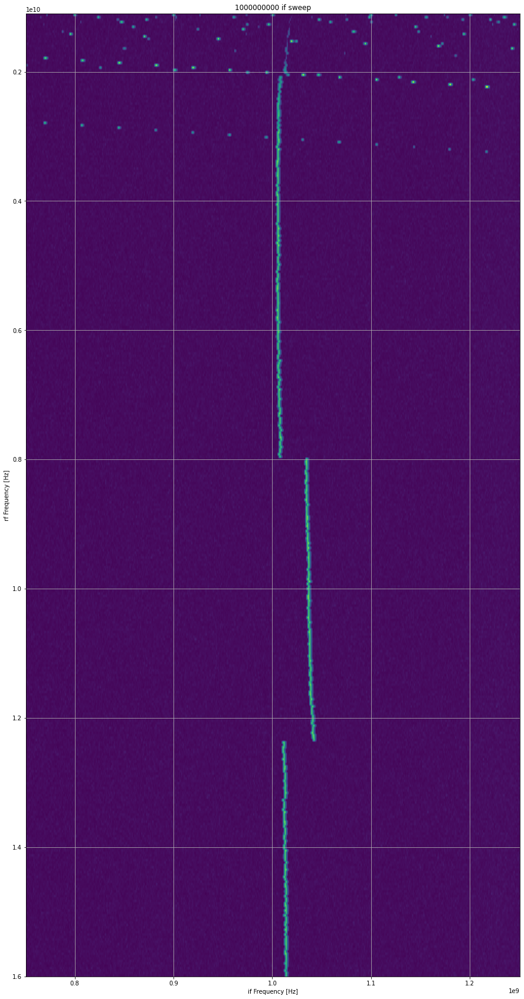

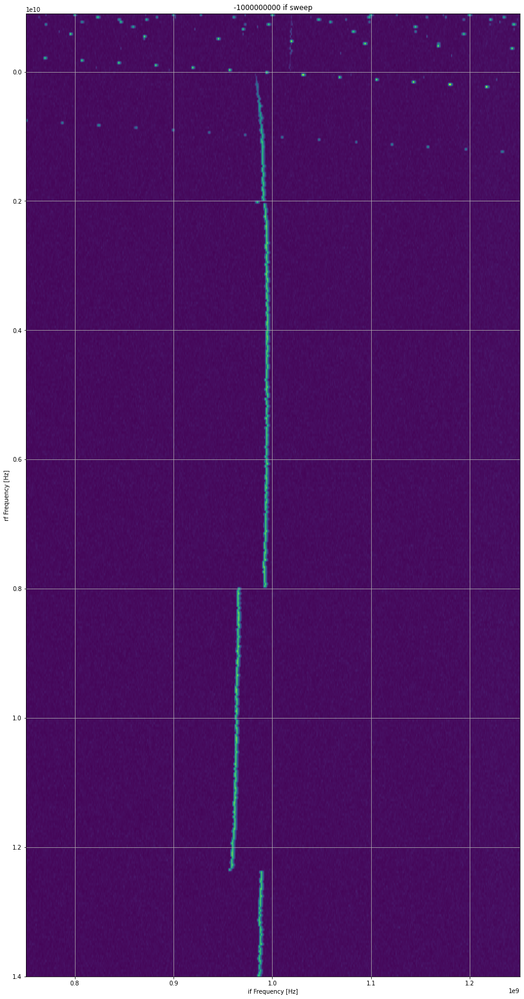

In [72]:
plt.rcParams['figure.figsize'] = [15, 30]
ifFreq = np.array([1, -1])*1e9
loSweep = np.linspace(0.1e9, 15e9, 401)
gen.setLevel(0)
mats = None
for iff in ifFreq:
    fmap, f = ifSweep(iff, loSweep)
    mats = (np.dstack((mats, fmap)) if (mats is not None) else fmap)
    plt.figure()
    plt.title("%d if sweep"%(iff))
    plt.imshow(fmap, extent=[min(f), max(f), max(loSweep)+iff, min(loSweep)+iff], aspect='auto')
    plt.xlabel('if Frequency [Hz]')
    plt.ylabel('rf Frequency [Hz]')
    plt.grid(True)
    plt.show()
#loSweep = np.linspace(0.1e9, 15e9, 300);
saveData('1GHz_if_sweeps.mat', {'freqs':f, 'ifFreqs': ifFreq, 'loSweep':loSweep, 'measuredData':mats})

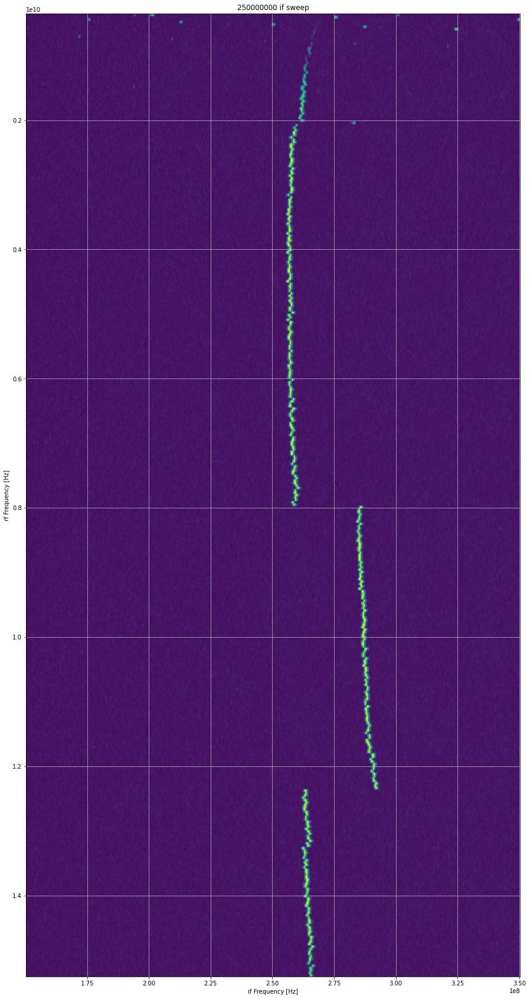

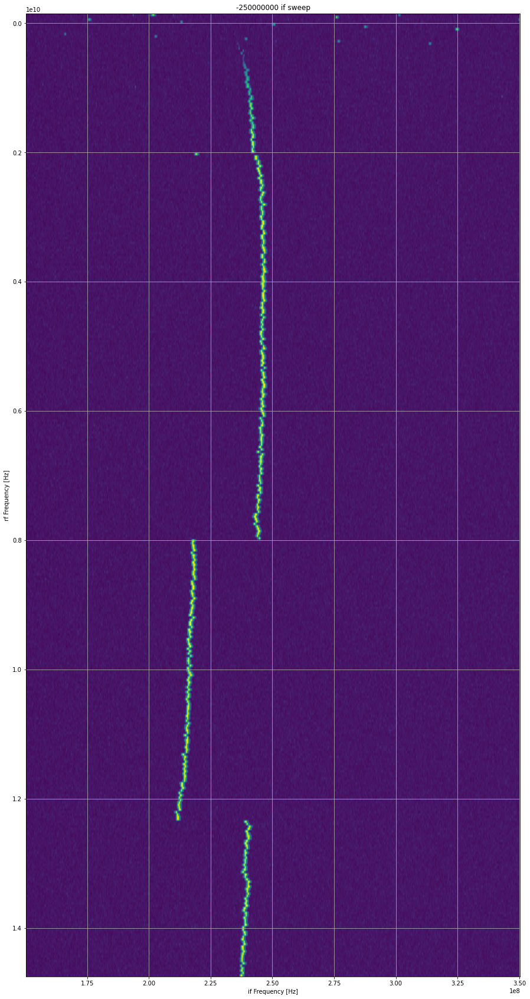

In [73]:
plt.rcParams['figure.figsize'] = [15, 30]
ifFreq = np.array([0.25, -0.25])*1e9
loSweep = np.linspace(0.1e9, 15e9, 401)
gen.setLevel(0)
mats = None
for iff in ifFreq:
    fmap, f = ifSweep(iff, loSweep)
    mats = (np.dstack((mats, fmap)) if (mats is not None) else fmap)
    plt.figure()
    plt.title("%d if sweep"%(iff))
    plt.imshow(fmap, extent=[min(f), max(f), max(loSweep)+iff, min(loSweep)+iff], aspect='auto')
    plt.xlabel('if Frequency [Hz]')
    plt.ylabel('rf Frequency [Hz]')
    plt.grid(True)
    plt.show()
#loSweep = np.linspace(0.1e9, 15e9, 300);
saveData('0_25GHz_if_sweeps.mat', {'freqs':f, 'ifFreqs': ifFreq, 'loSweep':loSweep, 'measuredData':mats})

## IF sweeps looking at 500MHz spans at mixer RF port

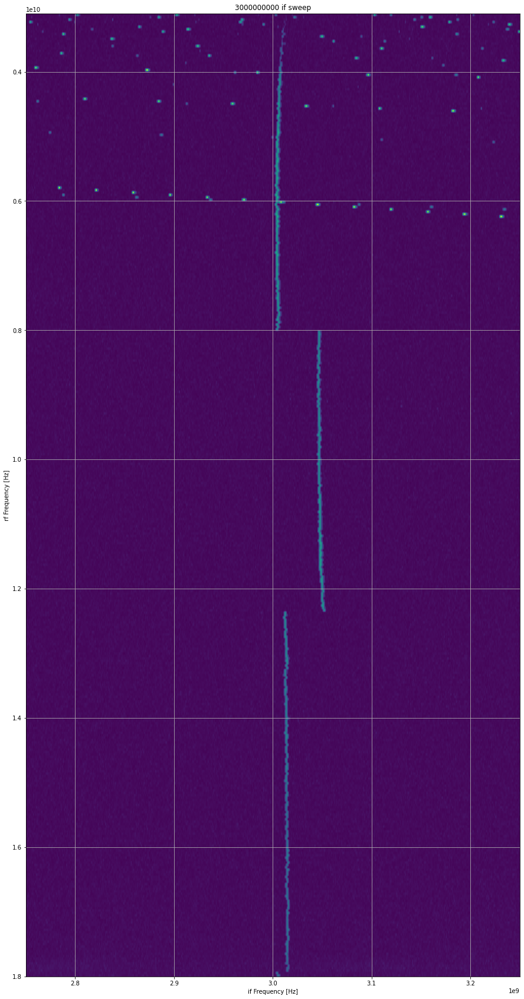

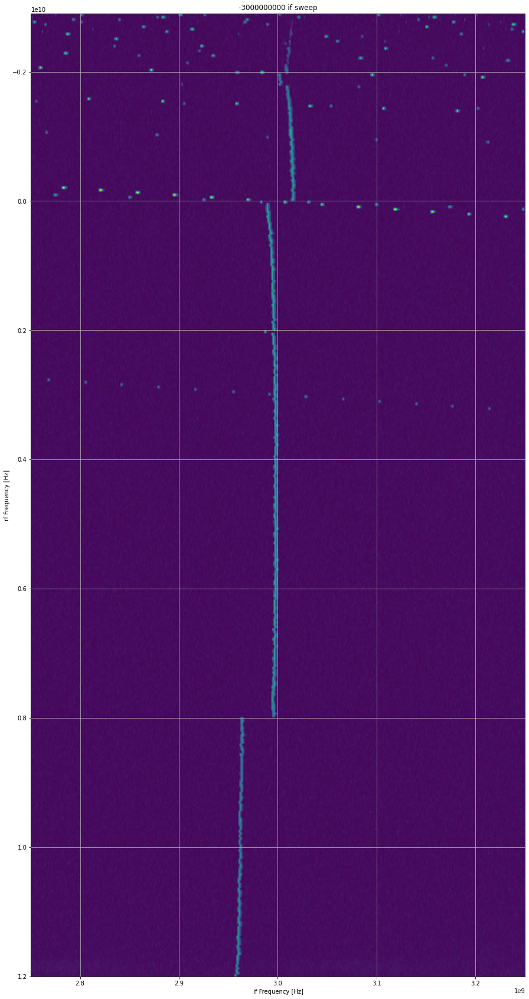

In [7]:
plt.rcParams['figure.figsize'] = [15, 30]
ifFreq = np.array([3, -3])*1e9
loSweep = np.linspace(0.1e9, 15e9, 401)
gen.setLevel(0)
mats = None
for iff in ifFreq:
    fmap, f = ifSweep(iff, loSweep)
    mats = (np.dstack((mats, fmap)) if (mats is not None) else fmap)
    plt.figure()
    plt.title("%d if sweep"%(iff))
    plt.imshow(fmap, extent=[min(f), max(f), max(loSweep)+iff, min(loSweep)+iff], aspect='auto')
    plt.xlabel('if Frequency [Hz]')
    plt.ylabel('rf Frequency [Hz]')
    plt.grid(True)
    plt.show()
#loSweep = np.linspace(0.1e9, 15e9, 300);
saveData('3GHz_rf_sweeps.mat', {'freqs':f, 'ifFreqs': ifFreq, 'loSweep':loSweep, 'measuredData':mats})

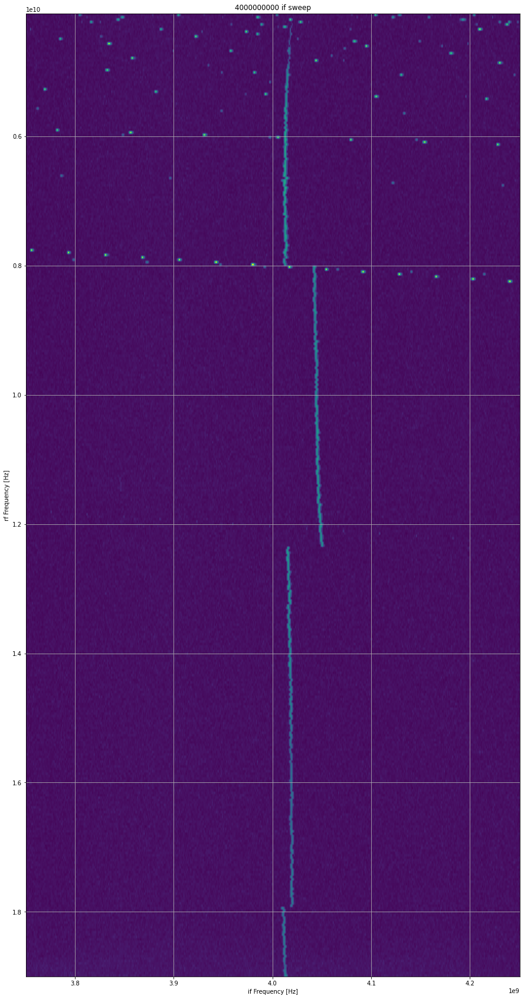

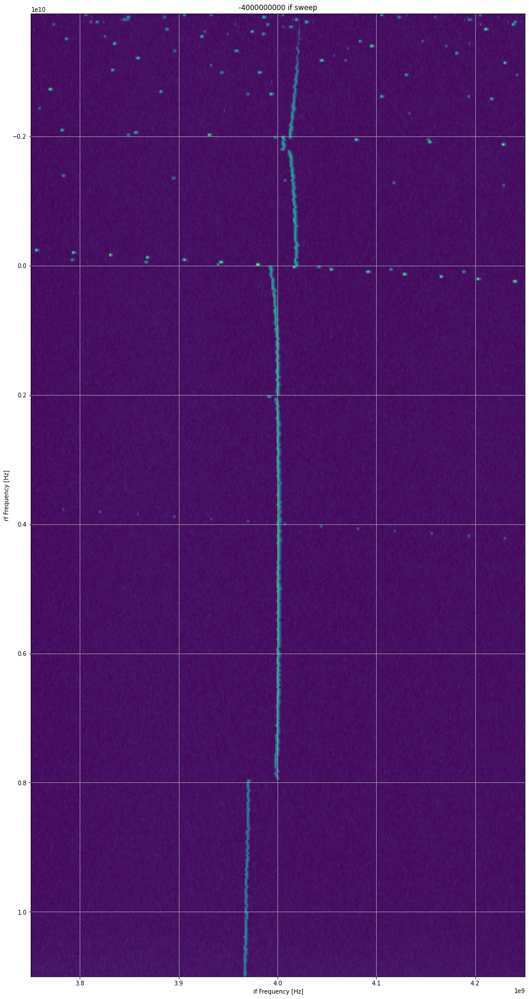

In [8]:
plt.rcParams['figure.figsize'] = [15, 30]
ifFreq = np.array([4, -4])*1e9
loSweep = np.linspace(0.1e9, 15e9, 401)
gen.setLevel(0)
mats = None
for iff in ifFreq:
    fmap, f = ifSweep(iff, loSweep)
    mats = (np.dstack((mats, fmap)) if (mats is not None) else fmap)
    plt.figure()
    plt.title("%d if sweep"%(iff))
    plt.imshow(fmap, extent=[min(f), max(f), max(loSweep)+iff, min(loSweep)+iff], aspect='auto')
    plt.xlabel('if Frequency [Hz]')
    plt.ylabel('rf Frequency [Hz]')
    plt.grid(True)
    plt.show()
#loSweep = np.linspace(0.1e9, 15e9, 300);
saveData('4GHz_rf_sweeps.mat', {'freqs':f, 'ifFreqs': ifFreq, 'loSweep':loSweep, 'measuredData':mats})